In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        pass
        # print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
%%capture
!pip install --upgrade ultralytics

In [3]:
!ls /kaggle/input/licence-plates-data/license\ plate\ recognition.v2/license\ plate\ recognition.v2

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


In [4]:
!cp  /kaggle/input/licence-plates-data/license\ plate\ recognition.v2/license\ plate\ recognition.v2/data.yaml .

In [5]:
!cat data.yaml

train: '/kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/train/images'
val: '/kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/valid/images'
test: '/kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images'

nc: 1
names: ['license-plate-annotation']

roboflow:
  workspace: vid-seszo
  project: license-plate-recognition-zbhcq
  version: 1
  license: CC BY 4.0
  url: https://universe.roboflow.com/vid-seszo/license-plate-recognition-zbhcq/dataset/1

In [6]:
import yaml

yaml_file_path = 'data.yaml'

with open(yaml_file_path, 'r') as file:
    config_data = yaml.safe_load(file)

In [7]:
import os
from ultralytics import YOLO
from glob import glob

import cv2, yaml, random, numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from torchvision import transforms as T


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


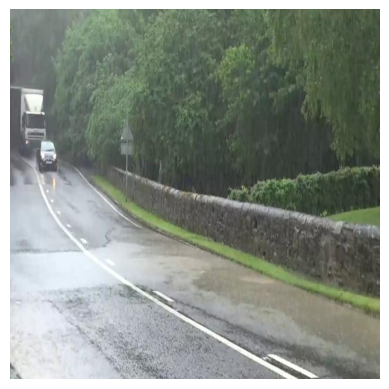

In [8]:
img = cv2.imread("/kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/train/images/frame_00002_jpg.rf.ea0d8b80b9276972b000f5158ca77052.jpg")
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)
plt.axis('off')
plt.show()

In [9]:
!cat /kaggle/input/licence-plates-data/license\ plate\ recognition.v2/license\ plate\ recognition.v2/train/labels/frame_00002_jpg.rf.ea0d8b80b9276972b000f5158ca77052.txt

0 0.10546875 0.41484375 0.02890625 0.02109375

In [10]:
model = YOLO("yolov8m.pt")
# print(model)

100%|██████████| 49.7M/49.7M [00:00<00:00, 219MB/s]


In [11]:
results = model.train(
    data="data.yaml", # Path to your data.yaml file
    epochs=20,       # Recommended starting point for fine-tuning. Adjust based on performance.
    imgsz=640,        # Input image size. Common choices are 640, 960, 1280.
    batch=16,         # Batch size. Reduce if you get out-of-memory errors.
    device=0,       # Uncomment and set to your GPU ID if you have multiple, or 'cpu' if no GPU.
    name='yolov_license_plate_finetune' # Optional: A name for your training run
    # cache=True,     # Optional: Cache images to RAM/disk for faster training (good for small datasets)
    # patience=50,    # Optional: Stop training if mAP doesn't improve for this many epochs
    # workers=8,      # Optional: Number of data loading workers. Adjust based on CPU cores.
)

Ultralytics 8.3.152 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov_license_plate_finetune, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretraine

100%|██████████| 755k/755k [00:00<00:00, 17.8MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.2MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.3±0.5 ms, read: 11.4±3.8 MB/s, size: 50.4 KB)


train: Scanning /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/train/labels... 1789 images, 6 backgrounds, 0 corrupt: 100%|██████████| 1789/1789 [00:05<00:00, 325.98it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.7±0.7 ms, read: 9.6±4.7 MB/s, size: 48.6 KB)


val: Scanning /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/valid/labels... 511 images, 0 backgrounds, 0 corrupt: 100%|██████████| 511/511 [00:01<00:00, 284.33it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/valid is not writeable, cache not saved.


Plotting labels to runs/detect/yolov_license_plate_finetune/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/yolov_license_plate_finetune
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      6.13G      1.984       2.07      1.237         15        640: 100%|██████████| 112/112 [00:57<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.93it/s]

                   all        511        511      0.138      0.268     0.0776     0.0326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      7.34G      1.876      1.077      1.152         10        640: 100%|██████████| 112/112 [01:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.16it/s]

                   all        511        511      0.244      0.306      0.096      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20       7.4G      1.869      1.086      1.144         17        640: 100%|██████████| 112/112 [01:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.12it/s]

                   all        511        511      0.535      0.587      0.481      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      6.28G       1.81      1.048      1.128         19        640: 100%|██████████| 112/112 [01:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        511        511     0.0372      0.898     0.0366     0.0163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      6.35G      1.767      1.008      1.114         25        640: 100%|██████████| 112/112 [01:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.775      0.859      0.762      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      6.41G      1.733     0.9314      1.097         20        640: 100%|██████████| 112/112 [01:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        511        511      0.859      0.892      0.892      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      6.48G      1.714     0.9391       1.09         15        640: 100%|██████████| 112/112 [01:01<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511       0.85      0.935       0.92      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      6.61G      1.709     0.8746      1.076         15        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.877      0.964      0.937      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      6.75G      1.676     0.8393      1.083         18        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.12it/s]

                   all        511        511      0.772      0.818      0.789      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      6.91G      1.673     0.8274      1.076         16        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.915      0.951      0.965      0.486


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      7.04G      1.645     0.8042      1.115         12        640: 100%|██████████| 112/112 [01:01<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        511        511      0.893      0.949      0.946      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      7.21G      1.641     0.7476      1.124         12        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.09it/s]

                   all        511        511       0.91      0.951      0.947      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      7.34G      1.627     0.7447      1.098         13        640: 100%|██████████| 112/112 [01:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.897      0.937      0.938      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      6.71G      1.622     0.7403      1.103         13        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.925      0.959      0.956      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      6.46G      1.609      0.722      1.109         12        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.12it/s]

                   all        511        511      0.938      0.955      0.975       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      6.41G      1.576     0.7048      1.098         12        640: 100%|██████████| 112/112 [01:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.927      0.967      0.966      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      6.42G       1.58     0.6974      1.096         13        640: 100%|██████████| 112/112 [01:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.13it/s]

                   all        511        511      0.945      0.955      0.971      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      6.38G       1.55     0.6566      1.087         12        640: 100%|██████████| 112/112 [01:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        511        511      0.938      0.971      0.982      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      6.38G      1.541     0.6442      1.081         12        640: 100%|██████████| 112/112 [01:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.12it/s]

                   all        511        511      0.943      0.965      0.979      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      6.37G      1.523     0.6372      1.065         10        640: 100%|██████████| 112/112 [01:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.11it/s]

                   all        511        511      0.957      0.965      0.984      0.535



20 epochs completed in 0.387 hours.
Optimizer stripped from runs/detect/yolov_license_plate_finetune/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/yolov_license_plate_finetune/weights/best.pt, 52.0MB

Validating runs/detect/yolov_license_plate_finetune/weights/best.pt...
Ultralytics 8.3.152 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        511        511      0.957      0.965      0.984      0.535
Speed: 0.2ms preprocess, 11.3ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/yolov_license_plate_finetune


In [12]:
!ls runs/detect/yolov_license_plate_finetune

args.yaml			 R_curve.png	      train_batch2.jpg
confusion_matrix_normalized.png  results.csv	      val_batch0_labels.jpg
confusion_matrix.png		 results.png	      val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch1120.jpg  val_batch1_pred.jpg
labels.jpg			 train_batch1121.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch1122.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch1.jpg     weights


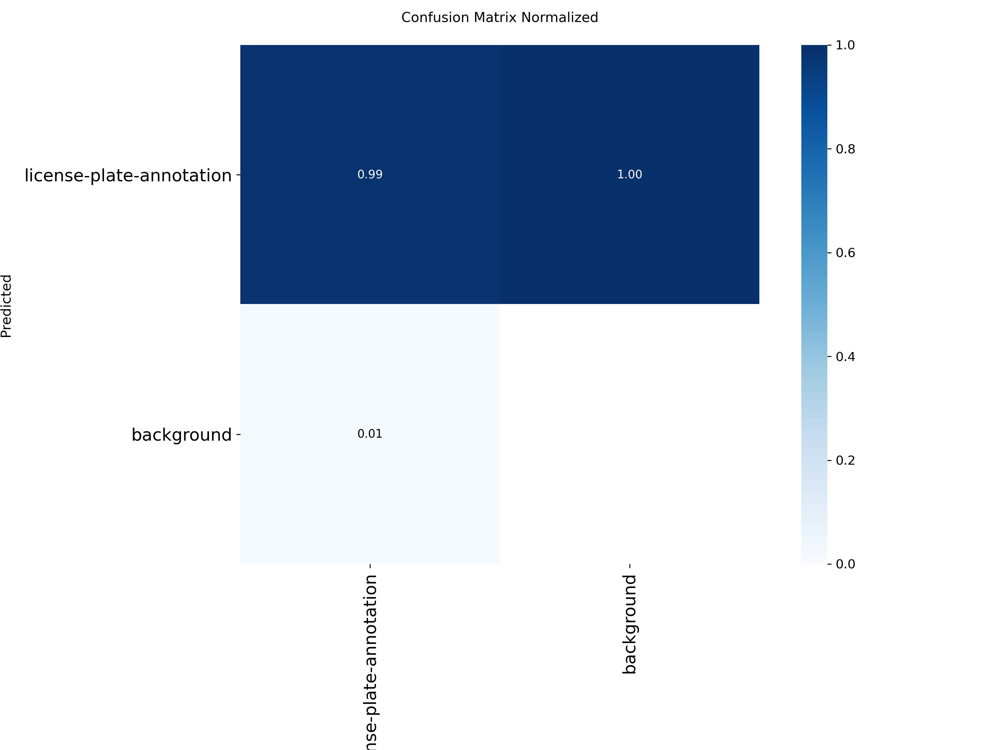

In [13]:
Image.open(f"runs/detect/yolov_license_plate_finetune/confusion_matrix_normalized.png")


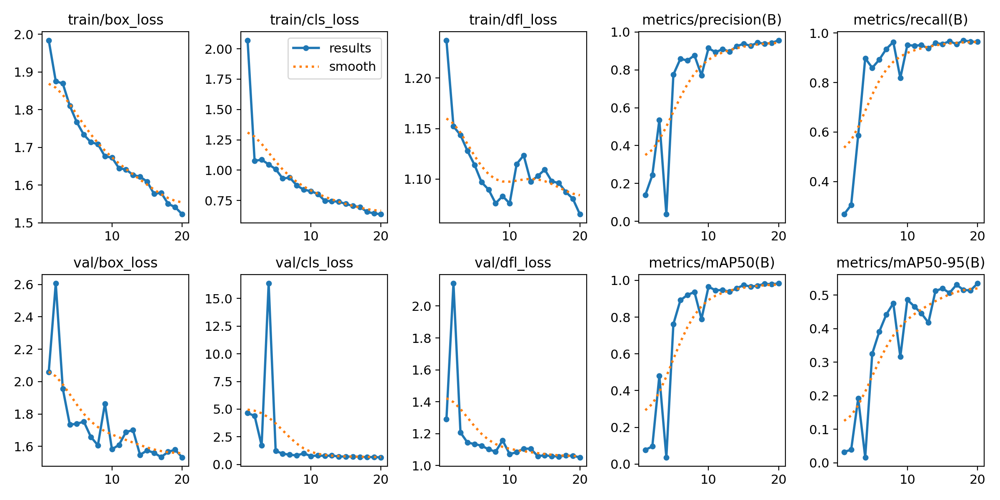

In [14]:
Image.open(f"runs/detect/yolov_license_plate_finetune/results.png")


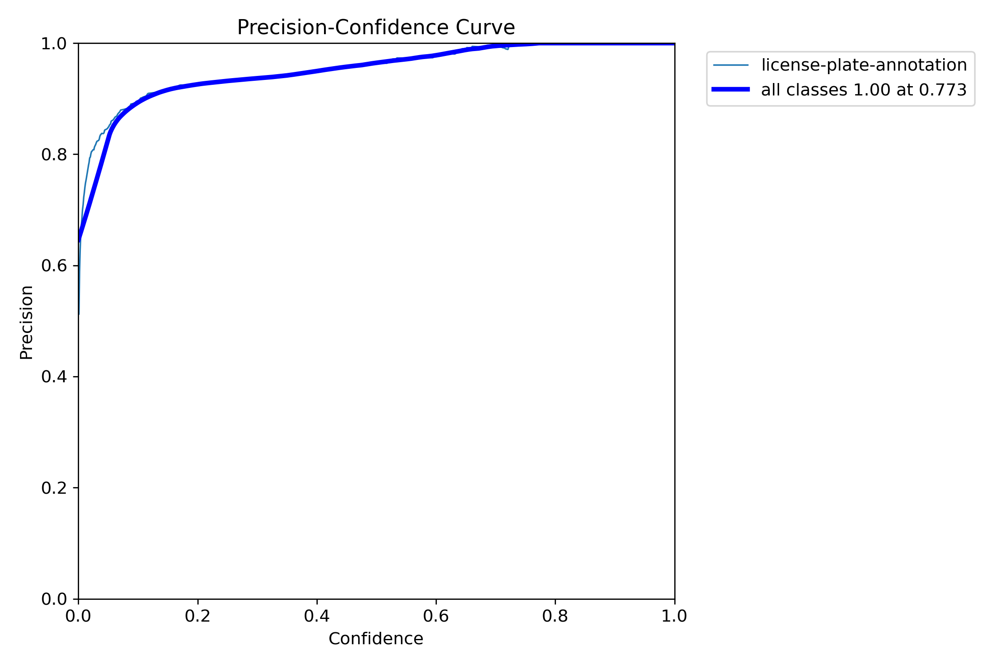

In [15]:
Image.open(f"runs/detect/yolov_license_plate_finetune/P_curve.png")


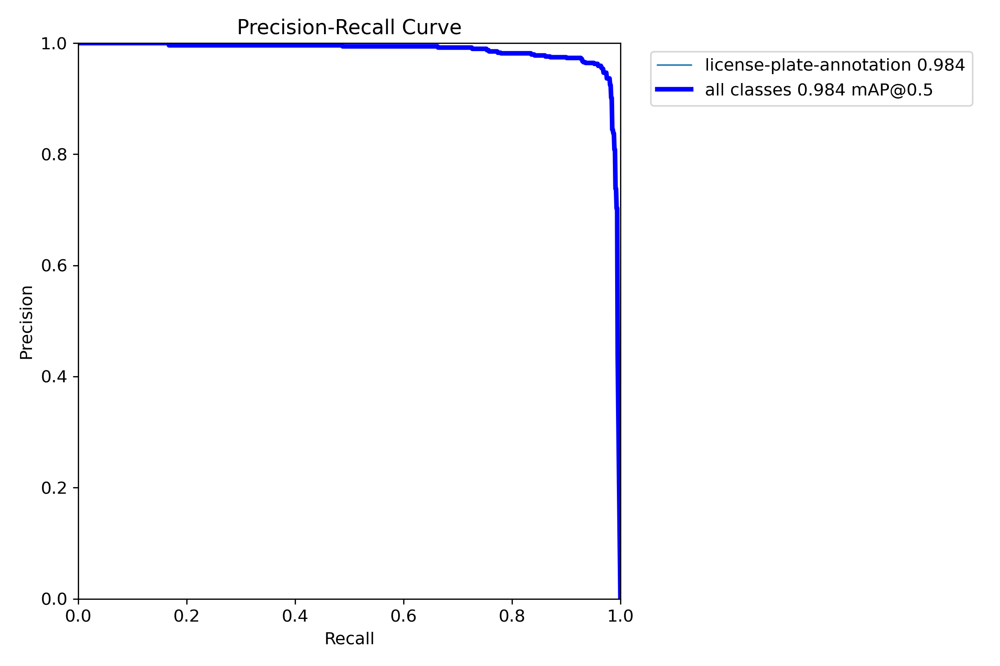

In [16]:
Image.open(f"runs/detect/yolov_license_plate_finetune/PR_curve.png")

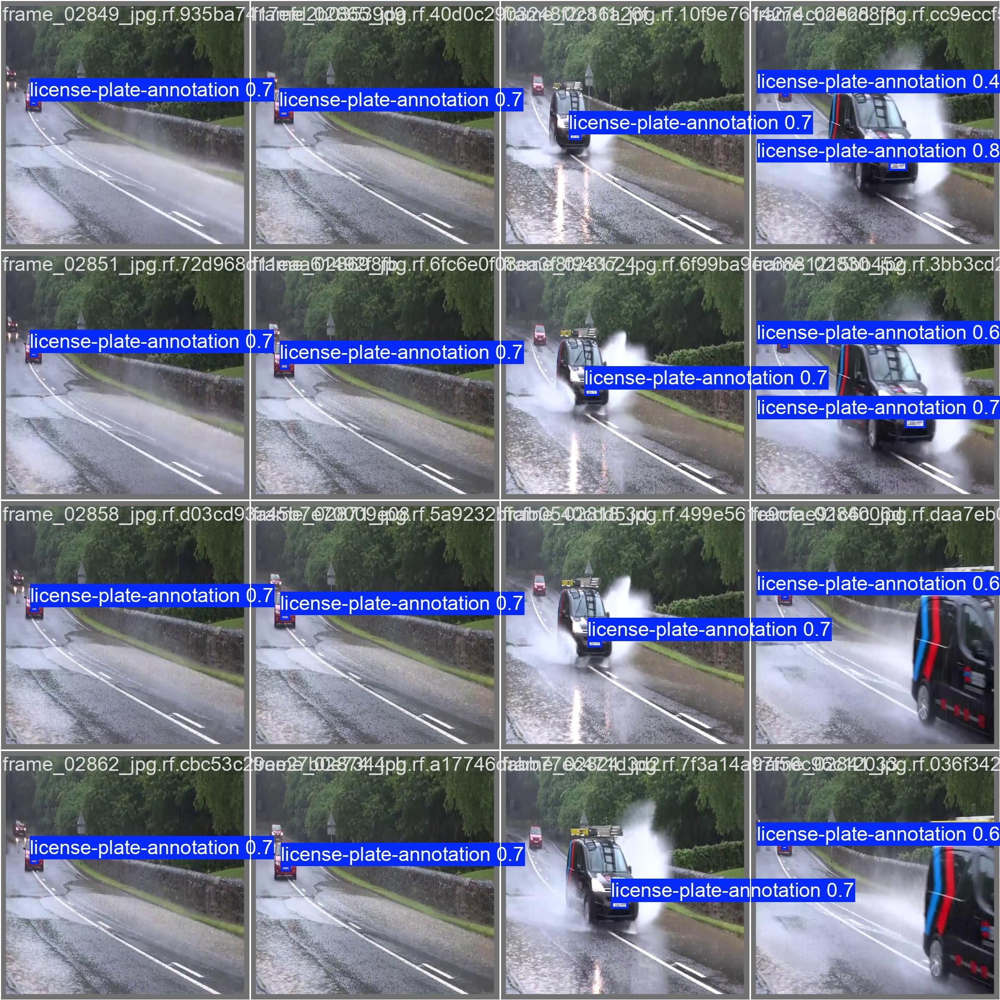

In [17]:
Image.open(f"runs/detect/yolov_license_plate_finetune/val_batch0_pred.jpg")

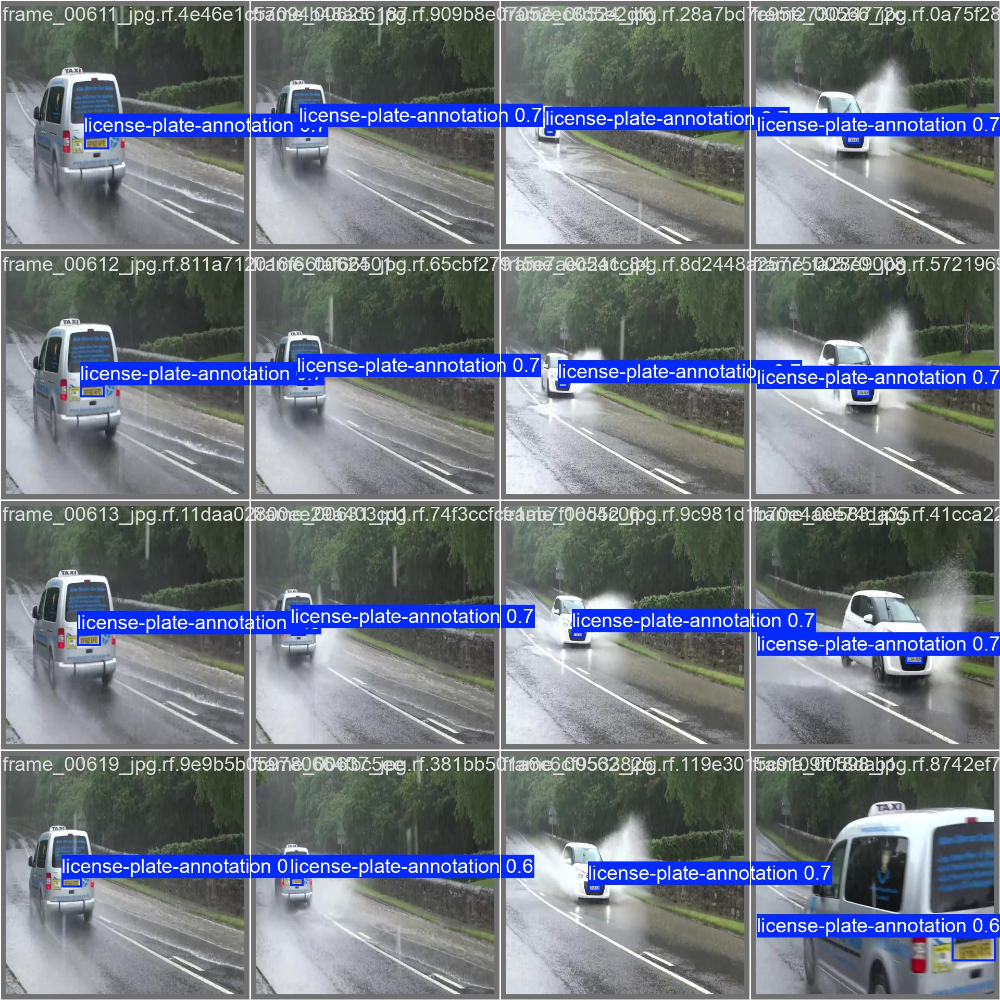

In [18]:
Image.open(f"runs/detect/yolov_license_plate_finetune/val_batch2_pred.jpg")

In [19]:
inference_results = model(config_data["test"], device = 0)


image 1/255 /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images/frame_00004_jpg.rf.ac70078e5ee3fa2ea1e9ca9be98baee9.jpg: 640x640 1 license-plate-annotation, 36.9ms
image 2/255 /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images/frame_00008_jpg.rf.3d2317320740c4cf5d241a19255791d1.jpg: 640x640 1 license-plate-annotation, 37.0ms
image 3/255 /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images/frame_00013_jpg.rf.e0f2b6d3859b3cc9b6b26f38da4bc0e9.jpg: 640x640 1 license-plate-annotation, 31.7ms
image 4/255 /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images/frame_00016_jpg.rf.f6350e731508b34b5b999890e87a10af.jpg: 640x640 1 license-plate-annotation, 25.3ms
image 5/255 /kaggle/input/licence-plates-data/license plate recognition.v2/license plate recognition.v2/test/images/frame_00047_jpg.rf.

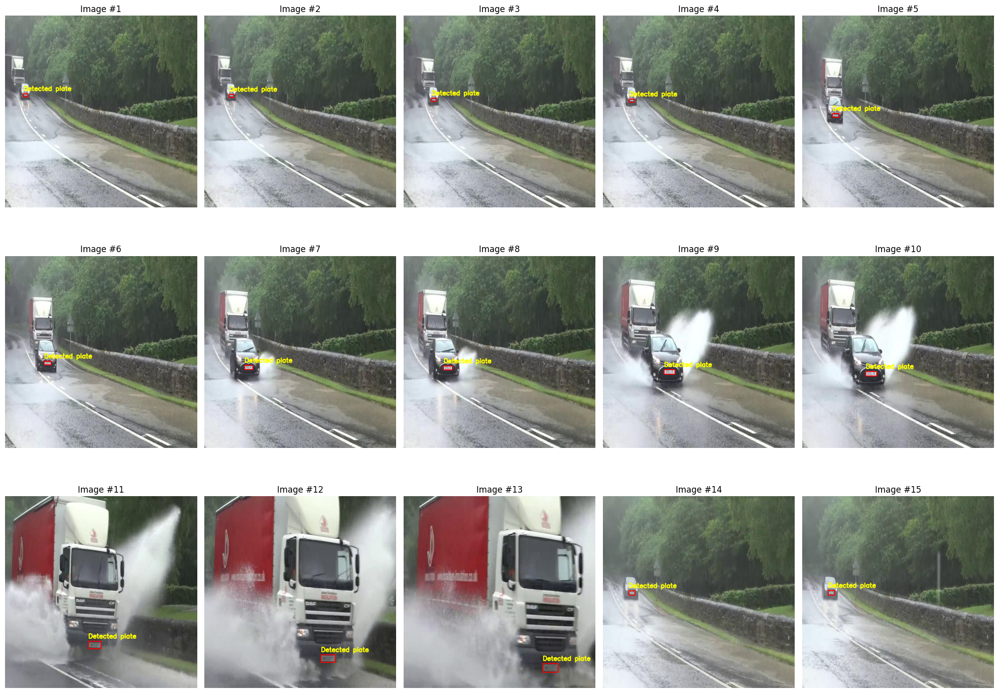

In [20]:
def plot_images(res, n_ims, rows):
    """
    Visualiza los resultados de la inferencia de YOLO, dibujando bounding boxes
    y etiquetando la detección como "Placa Detectada".

    Args:
        res (list of Results objects): La lista de resultados de la inferencia del modelo YOLO.
                                       Cada elemento 'r' en 'res' es un objeto Results.
        n_ims (int): El número máximo de imágenes a mostrar.
        rows (int): El número de filas para la cuadrícula de visualización.
    """
    cols = n_ims // rows
    if n_ims % rows != 0: # Ajustar columnas si n_ims no es múltiplo de rows
        cols += 1

    plt.figure(figsize=(20, 5 * rows)) # Ajustar figsize para un mejor layout vertical

    for idx, r in enumerate(res):
        if idx >= n_ims: # Usa '>=' para asegurar que no se exceda el número de imágenes
            break

        plt.subplot(rows, cols, idx + 1)

        or_im_rgb = r.orig_img # Esto suele ser un array NumPy (BGR)
        if or_im_rgb.ndim == 3 and or_im_rgb.shape[2] == 3: # Check if it's a 3-channel image
             or_im_rgb = cv2.cvtColor(or_im_rgb, cv2.COLOR_BGR2RGB)

        for bbox in r.boxes:
            x1, y1, x2, y2 = map(int, bbox.xyxy[0].tolist())
            coord1 = (x1, y1)
            coord2 = (x2, y2)

            cv2.rectangle(or_im_rgb, coord1, coord2, color=(255, 0, 0), thickness=2) 

            text = "Detected plate"
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 0.7
            font_thickness = 2
            text_color = (255, 255, 0) # Amarillo (RGB)

            (text_width, text_height), baseline = cv2.getTextSize(text, font, font_scale, font_thickness)

            text_x = x1
            text_y = y1 - 10 if y1 - 10 > text_height + 5 else y2 + text_height + 5 # Ajuste para no salir de la imagen

            cv2.putText(or_im_rgb, text, (text_x, text_y), font, font_scale, text_color, font_thickness, cv2.LINE_AA)

        plt.imshow(or_im_rgb)
        plt.title(f"Image #{idx + 1}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

plot_images(res=inference_results, n_ims=15, rows=3)

In [21]:
!ls runs/detect/yolov_license_plate_finetune/weights

best.pt  last.pt


100%|██████████| 250k/250k [00:00<00:00, 4.57MB/s]

image 1/1 /kaggle/working/Donceles-Ciudad-de-México-1200x853.jpg: 480x640 1 license-plate-annotation, 44.8ms
Speed: 2.5ms preprocess, 44.8ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


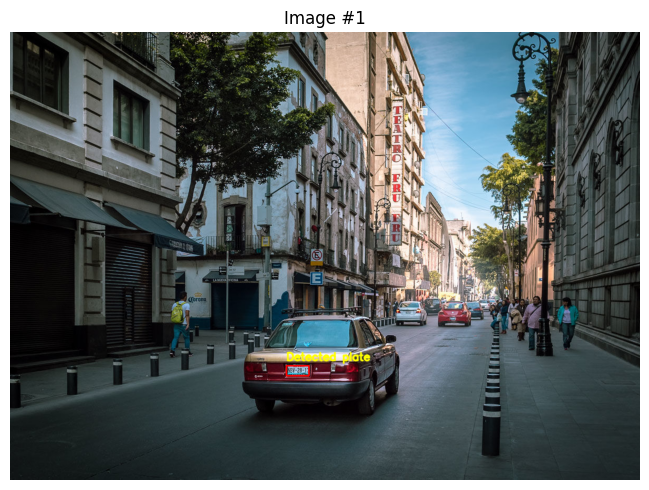

In [22]:
model = YOLO("runs/detect/yolov_license_plate_finetune/weights/best.pt") 

image_url = "https://cdn1.matadornetwork.com/blogs/2/2018/04/Donceles-Ciudad-de-M%C3%A9xico-1200x853.jpg"

results = model.predict(source=image_url, conf=0.01, iou=0.01, show=False, save=False)

plot_images(res=results, n_ims=1, rows=1)

100%|██████████| 59.5k/59.5k [00:00<00:00, 1.99MB/s]

image 1/1 /kaggle/working/depositphotos_8289907-stock-photo-traffic-jam-in-the-road.jpg: 448x640 2 license-plate-annotations, 41.9ms
Speed: 1.9ms preprocess, 41.9ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


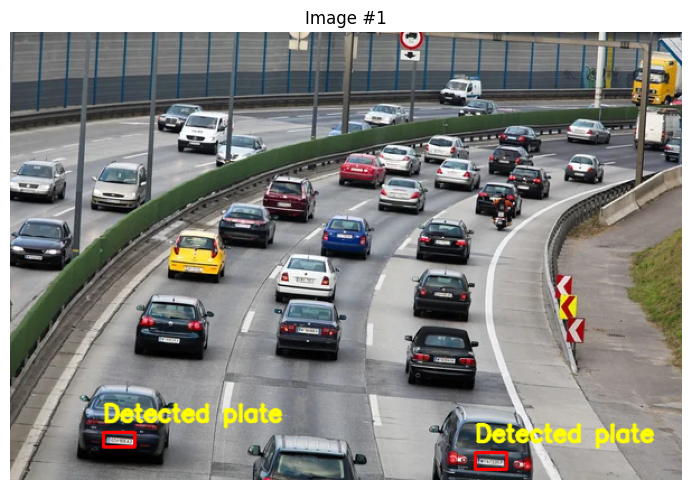

In [23]:
model = YOLO("runs/detect/yolov_license_plate_finetune/weights/best.pt") 

image_url = "https://static8.depositphotos.com/1031551/828/i/450/depositphotos_8289907-stock-photo-traffic-jam-in-the-road.jpg"

results = model.predict(source=image_url, conf=0.25, iou=0.7, show=False, save=False)

plot_images(res=results, n_ims=1, rows=1)

In [24]:
# path_to_pretrained_weights = 'runs/detect/yolov_license_plate_finetune2/weights/last.pt'
# # O 'runs/detect/yolov11_license_plate_finetune/weights/best.pt' si quieres continuar desde el mejor rendimiento

# model = YOLO(path_to_pretrained_weights)

# results = model.train(
#     data="data.yaml", # Path to your data.yaml file
#     epochs=50,       # Recommended starting point for fine-tuning. Adjust based on performance.
#     imgsz=640,        # Input image size. Common choices are 640, 960, 1280.
#     batch=16,         # Batch size. Reduce if you get out-of-memory errors.
#     device=0,       # Uncomment and set to your GPU ID if you have multiple, or 'cpu' if no GPU.
#     name='yolov11_license_plate_finetune_more_epochs' # Optional: A name for your training run
# )